# Final Project

## Read Cleveland Heart Disease Dataset

In [67]:
import pandas as pd
import numpy as np
from time import time

In [68]:

file_path = "/Users/yujieming/Study/Master's/2024-fall/SYDE 522/Final Project/heart+disease/processed.cleveland.data"
column_names = ['age', 'sex', 'cp', 'trestbps', 'chol', 'fbs', 'restecg',
                'thalach', 'exang', 'oldpeak', 'slope', 'ca', 'thal', 'num']
df = pd.read_csv(file_path, delimiter=",", names=column_names, header=None)

In [69]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 303 entries, 0 to 302
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       303 non-null    float64
 1   sex       303 non-null    float64
 2   cp        303 non-null    float64
 3   trestbps  303 non-null    float64
 4   chol      303 non-null    float64
 5   fbs       303 non-null    float64
 6   restecg   303 non-null    float64
 7   thalach   303 non-null    float64
 8   exang     303 non-null    float64
 9   oldpeak   303 non-null    float64
 10  slope     303 non-null    float64
 11  ca        303 non-null    object 
 12  thal      303 non-null    object 
 13  num       303 non-null    int64  
dtypes: float64(11), int64(1), object(2)
memory usage: 33.3+ KB


In [70]:
# Count the number of times '0' appears in the 'num' column of the DataFrame.
zero_count = df['num'].value_counts().get(0, 0)
print(f"The number 0 appears {zero_count} times in the 'num' column.")

The number 0 appears 164 times in the 'num' column.


## Preprocessing

### Replace missing values

In [71]:
# Find rows with "?" in any column
rows_with_question_marks = df[df.apply(lambda row: row.astype(str).str.contains('\?').any(), axis=1)]

# Display the rows with "?"
rows_with_question_marks

<>:2: SyntaxWarning: invalid escape sequence '\?'
<>:2: SyntaxWarning: invalid escape sequence '\?'
/var/folders/rj/rdt4n7wx241065t043w0hlvw0000gn/T/ipykernel_34294/2278389959.py:2: SyntaxWarning: invalid escape sequence '\?'
  rows_with_question_marks = df[df.apply(lambda row: row.astype(str).str.contains('\?').any(), axis=1)]


,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num
87,53.0,0.0,3.0,128.0,216.0,0.0,2.0,115.0,0.0,0.0,1.0,0.0,?,0
166,52.0,1.0,3.0,138.0,223.0,0.0,0.0,169.0,0.0,0.0,1.0,?,3.0,0
192,43.0,1.0,4.0,132.0,247.0,1.0,2.0,143.0,1.0,0.1,2.0,?,7.0,1
266,52.0,1.0,4.0,128.0,204.0,1.0,0.0,156.0,1.0,1.0,2.0,0.0,?,2
287,58.0,1.0,2.0,125.0,220.0,0.0,0.0,144.0,0.0,0.4,2.0,?,7.0,0
302,38.0,1.0,3.0,138.0,175.0,0.0,0.0,173.0,0.0,0.0,1.0,?,3.0,0


In [72]:
# replace ? with mode
df_copy = df.copy()

for col in df.columns:
    if df_copy[col].dtype == 'object':  # Check if the column is of object type (likely contains strings)
        mode_val = df_copy[col].dropna().astype(str).mode()[0]  # Use mode for string columns
        df_copy[col] = df[col].replace('?', mode_val)

    elif pd.api.types.is_numeric_dtype(df_copy[col]):  # Check if the column is numeric
        mode_val = df_copy[col].astype('float64').mode()[0]
        df_copy[col] = df_copy[col].replace('?', mode_val)

### Change "object" datatype to "float64"

In [ ]:
# prompt: for df_copy, change column "ca", "thal" datatype to float64

# df_copy['ca'] = df_copy['ca'].astype('float64')
# df_copy['thal'] = df_copy['thal'].astype('float64')

### Change labels and plot its distribution

In [73]:
# we want to predict the presence of heart disease (binary classification)
# change labels 2,3,4 to 1
df_copy['num'] = df_copy['num'].replace([2, 3, 4], 1)

In [74]:
# Split data into features and target
Features = df_copy.drop('num', axis=1)
Labels = df_copy['num']

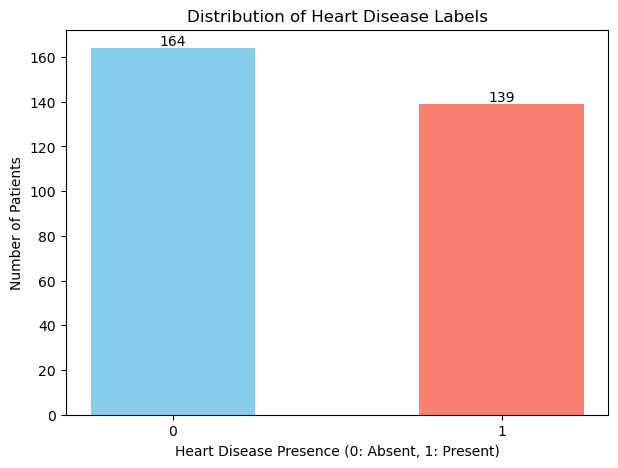

In [75]:
import matplotlib.pyplot as plt

# Count the occurrences of each label
label_counts = Labels.value_counts()

plt.figure(figsize=(7, 5))
bars = plt.bar(label_counts.index, label_counts.values, width=0.5, color=['skyblue', 'salmon'])  # Different colors for 0 and 1

plt.xlabel('Heart Disease Presence (0: Absent, 1: Present)')
plt.xticks([0, 1])
plt.ylabel('Number of Patients')
plt.title('Distribution of Heart Disease Labels')

for bar, count in zip(bars, label_counts.values):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), str(count), ha='center', va='bottom')

plt.show()

In [76]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 303 entries, 0 to 302
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       303 non-null    float64
 1   sex       303 non-null    float64
 2   cp        303 non-null    float64
 3   trestbps  303 non-null    float64
 4   chol      303 non-null    float64
 5   fbs       303 non-null    float64
 6   restecg   303 non-null    float64
 7   thalach   303 non-null    float64
 8   exang     303 non-null    float64
 9   oldpeak   303 non-null    float64
 10  slope     303 non-null    float64
 11  ca        303 non-null    object 
 12  thal      303 non-null    object 
 13  num       303 non-null    int64  
dtypes: float64(11), int64(1), object(2)
memory usage: 33.3+ KB


### Train Val Test Split

In [ ]:
# from sklearn.model_selection import train_test_split

# # Split the data into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(Features, Labels, test_size=0.25, random_state=42) # 80% train
# print("X_train shape:", X_train.shape)
# print("y_train shape:", y_train.shape)
# print("X_test shape:", X_test.shape)
# print("y_test shape:", y_test.shape)


X_train shape: (227, 13)
y_train shape: (227,)
X_test shape: (76, 13)
y_test shape: (76,)


In [77]:
from sklearn.model_selection import train_test_split

X_train_val, X_test, y_train_val, y_test = train_test_split(
    Features, Labels, test_size=0.15, random_state=42
)

X_train, X_val, y_train, y_val = train_test_split(
    X_train_val, y_train_val, test_size=0.15 / 0.85, random_state=42
)

print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_val shape:", X_val.shape)
print("y_val shape:", y_val.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)

X_train shape: (211, 13)
y_train shape: (211,)
X_val shape: (46, 13)
y_val shape: (46,)
X_test shape: (46, 13)
y_test shape: (46,)


### Normalization -> Replaced with standardization

In [ ]:
# from sklearn.preprocessing import MinMaxScaler
# from sklearn.preprocessing import StandardScaler

# scaler = StandardScaler()

# # Fit the scaler to the training data
# scaler.fit(X_train)

# # Transform both the training and testing data using the fitted scaler
# X_train_scaled = scaler.transform(X_train)
# X_test_scaled = scaler.transform(X_test)

### Correlation Matrix

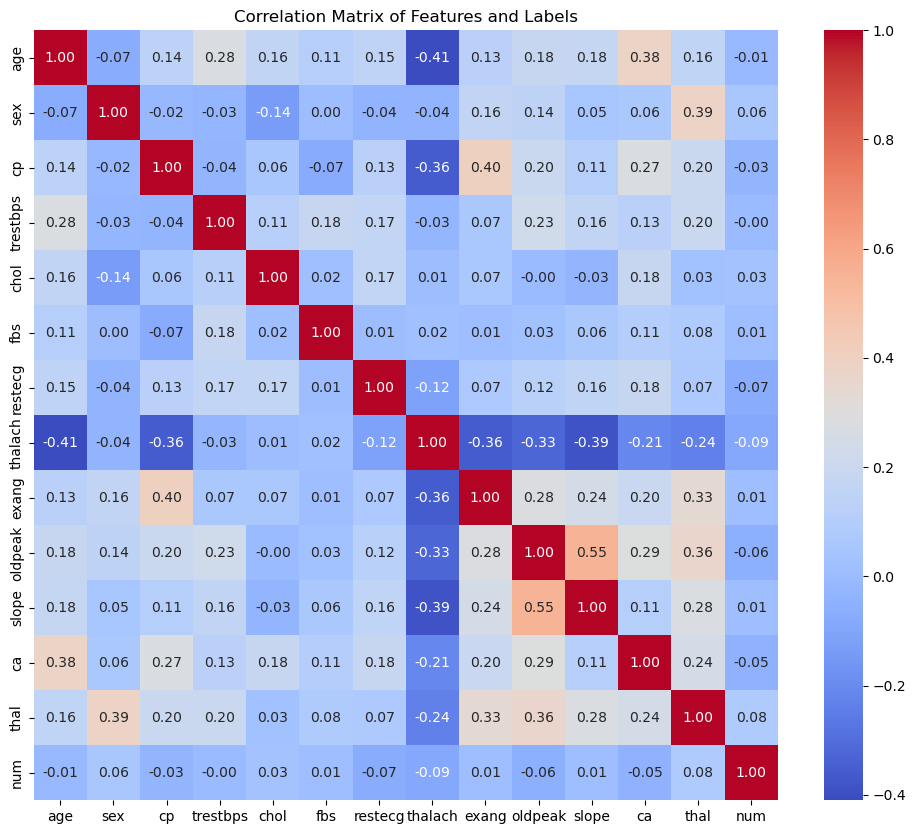

In [78]:
import seaborn as sns

# Combine features and labels for correlation analysis
X_train_scaled_df = pd.DataFrame(X_train_scaled, columns=['age', 'sex', 'cp', 'trestbps',
         'chol', 'fbs', 'restecg','thalach', 'exang', 'oldpeak', 'slope', 'ca', 'thal'])
train_data = pd.concat([X_train_scaled_df, y_train], axis=1)

# Calculate the correlation matrix
correlation_matrix = train_data.corr()

# Plotting the correlation matrix using a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Features and Labels')
plt.show()

### PCA

In [ ]:
# from sklearn.decomposition import PCA

# # Initialize PCA with the desired explained variance ratio
# pca = PCA(n_components=0.80)  # Keep 80% of the variance

# # Fit PCA on the scaled training data
# pca.fit(X_train_scaled)

# # Transform the training and testing data using the fitted PCA
# X_train_scaled_pca = pca.transform(X_train_scaled)
# X_test_scaled_pca = pca.transform(X_test_scaled)

# print("Number of components kept:", pca.n_components_)
# print("X_train_pca shape:", X_train_scaled_pca.shape)
# print("X_test_pca shape:", X_test_scaled_pca.shape)

Number of components kept: 8
X_train_pca shape: (227, 8)
X_test_pca shape: (76, 8)


## Logistic Regression

In [36]:
# Import libraries for training
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score, KFold



In [37]:
# Pick 5% of the training set
train_size = int(0.05 * len(X_train_scaled_pca))
X_train_small = X_train_scaled_pca[:train_size]
y_train_small = y_train[:train_size]

# Set regularization to zero and train Logistic Regression
logreg = LogisticRegression(penalty='l2', C=1e9, solver='lbfgs', max_iter=500) # C=1e9 effectively sets regularization to zero
logreg.fit(X_train_small, y_train_small)

# Make predictions on the small training set
y_pred = logreg.predict(X_train_small)

# Calculate Mean Squared Error
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_train_small, y_pred)
print(f"Mean Squared Error on the small training set: {mse}")

Mean Squared Error on the small training set: 0.0


In [38]:
# Logistic Regression
# Apply Grid search and K-fold cross validation to tune hyperparameters

from sklearn.model_selection import GridSearchCV

# Define the parameter grid for Logistic Regression
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000], # Regularization strength
}

# Initialize Logistic Regression
logreg = LogisticRegression(penalty='l2', max_iter=500)

# Perform GridSearchCV
grid_search = GridSearchCV(logreg, param_grid, cv=5, scoring='accuracy')  # 5-fold cross-validation
start = time()
grid_search.fit(X_train_scaled_pca, y_train)
end = time()
print("search time: ", end - start)
# Print the best hyperparameters and accuracy
print("Best hyperparameters:", grid_search.best_params_)
print("Validation accuracy:", grid_search.best_score_)


search time:  0.0502779483795166
Best hyperparameters: {'C': 0.01}
Validation accuracy: 0.8370048309178744


In [40]:
from sklearn.metrics import accuracy_score

# use the best hyperparameter to train on whole train set
tuned_logreg = LogisticRegression(penalty='l2', C=1, solver='lbfgs', max_iter=500)
tuned_logreg.fit(X_train_scaled_pca, y_train)

y_train_pred = tuned_logreg.predict(X_train_scaled_pca)
y_pred_lr = tuned_logreg.predict(X_test_scaled_pca)
print(f"Training Accuracy: {accuracy_score(y_train, y_train_pred)}")
print(f"Testing Accuracy: {accuracy_score(y_test, y_pred_lr)}")


Training Accuracy: 0.8281938325991189
Testing Accuracy: 0.8552631578947368


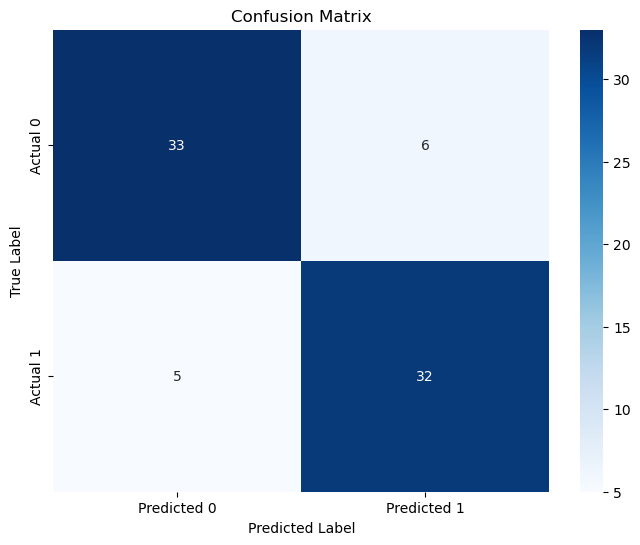

In [41]:
# Plot confusion matrix

cm = confusion_matrix(y_test, y_pred_lr)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

## SVM

In [48]:
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import mean_squared_error

# Pick 5% of the training set
train_size = int(0.05 * len(X_train_scaled_pca))
X_train_small = X_train_scaled_pca[:train_size]
y_train_small = y_train[:train_size]

# Set regularization to zero
svm = SGDClassifier(loss='hinge', penalty=None, max_iter=500, random_state=42) # penalty=None sets regularization to zero
svm.fit(X_train_small, y_train_small)

# Make predictions
y_pred = svm.predict(X_train_small)

# Calculate Mean Squared Error
mse = mean_squared_error(y_train_small, y_pred)
print(f"Mean Squared Error on the small training set: {mse}")

Mean Squared Error on the small training set: 0.0


### SVM without PCA

In [52]:
from sklearn.linear_model import SGDClassifier
# Define the parameter grid for SVM
param_grid2 = {# 'penalty': ['l1', 'l2'],
              'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
              'eta0': [0.0001, 0.001, 0.01, 0.1, 1, 10],
              'learning_rate': ['constant', 'optimal', 'invscaling', 'adaptive']
              }

# Initialize SGDClassifier
svm = SGDClassifier(loss='hinge', penalty='l2', max_iter=500, random_state=42)

# Perform GridSearchCV
grid_search2_2 = GridSearchCV(svm, param_grid2, cv=5, scoring='accuracy')  # 5-fold cross-validation
start = time()
grid_search2_2.fit(X_train_scaled, y_train)
end = time()
print("search time: ", end - start)

# Print the best hyperparameters and accuracy
print("Best hyperparameters:", grid_search2_2.best_params_)
print("Validation accuracy:", grid_search2_2.best_score_)

search time:  0.563978910446167
Best hyperparameters: {'alpha': 1, 'eta0': 1, 'learning_rate': 'invscaling'}
Validation accuracy: 0.8369082125603866


In [53]:
tuned_svm_2 = SGDClassifier(loss='hinge', penalty='l2', alpha=0.001, eta0=0.1, learning_rate='invscaling', max_iter=500, random_state=42)
tuned_svm_2.fit(X_train_scaled, y_train)

y_train_pred = tuned_svm_2.predict(X_train_scaled)
y_pred_svm_2 = tuned_svm_2.predict(X_test_scaled)
print(f"Training Accuracy: {accuracy_score(y_train, y_train_pred)}")
print(f"Testing Accuracy: {accuracy_score(y_test, y_pred_svm)}")

Training Accuracy: 0.8370044052863436
Testing Accuracy: 0.7763157894736842


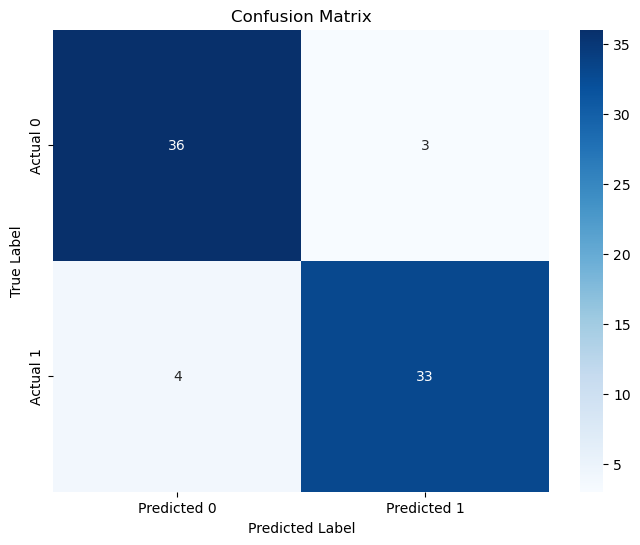

In [54]:
cm = confusion_matrix(y_test, y_pred_svm_2)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

## Decision Tree

In [78]:
from sklearn.tree import DecisionTreeClassifier

# Pick 5% of the training set
train_size = int(0.05 * len(X_train_scaled_pca))
X_train_small = X_train_scaled_pca[:train_size]
y_train_small = y_train[:train_size]

# Set regularization to zero and train Decision Tree
dt = DecisionTreeClassifier(ccp_alpha=0) # ccp_alpha=0 effectively sets regularization to zero
dt.fit(X_train_small, y_train_small)

# Make predictions
y_pred = dt.predict(X_train_small)

# Calculate Mean Squared Error
mse = mean_squared_error(y_train_small, y_pred)
print(f"Mean Squared Error on the small training set: {mse}")

Mean Squared Error on the small training set: 0.0


### DT without PCA

In [189]:
param_grid3_2 = {
                'criterion': ['gini', 'entropy'],
                'max_depth': [5, 6, 7, 8, 9, 10],  # Wider range of values
                'min_samples_split': [2, 3, 4, 5, 6, 7, 8],
                'min_samples_leaf': [1, 2, 3, 4, 5],
                'splitter': ['best', 'random']
                # 'max_features': ['auto', 'sqrt', 'log2']  # Added max_features
}

# Initialize Decision Tree Classifier
dt = DecisionTreeClassifier(random_state=42)

# Perform GridSearchCV
grid_search3_2 = GridSearchCV(dt, param_grid3_2, cv=5, scoring='accuracy')  # 5-fold cross-validation
start = time()
grid_search3_2.fit(X_train_scaled, y_train) # fit data without PCA
end = time()
print("search time: ", end - start)
# Print the best hyperparameters and accuracy
print("Best hyperparameters:", grid_search3_2.best_params_)
print("Validation accuracy:", grid_search3_2.best_score_)

search time:  15.579789876937866
Best hyperparameters: {'criterion': 'gini', 'max_depth': 7, 'min_samples_leaf': 3, 'min_samples_split': 2, 'splitter': 'random'}
Validation accuracy: 0.8365217391304347


In [191]:
# use the best hyperparameter to train on whole train set
tuned_dt_2 = DecisionTreeClassifier(criterion='gini', max_depth=7, min_samples_leaf=3, min_samples_split=2, splitter='random', random_state=42)
tuned_dt_2.fit(X_train_scaled, y_train)

y_train_pred = tuned_dt_2.predict(X_train_scaled)
y_pred_dt_2 = tuned_dt_2.predict(X_test_scaled)
print(f"Training Accuracy: {accuracy_score(y_train, y_train_pred)}")
print(f"Testing Accuracy: {accuracy_score(y_test, y_pred_dt_2)}")

Training Accuracy: 0.9074889867841409
Testing Accuracy: 0.7763157894736842


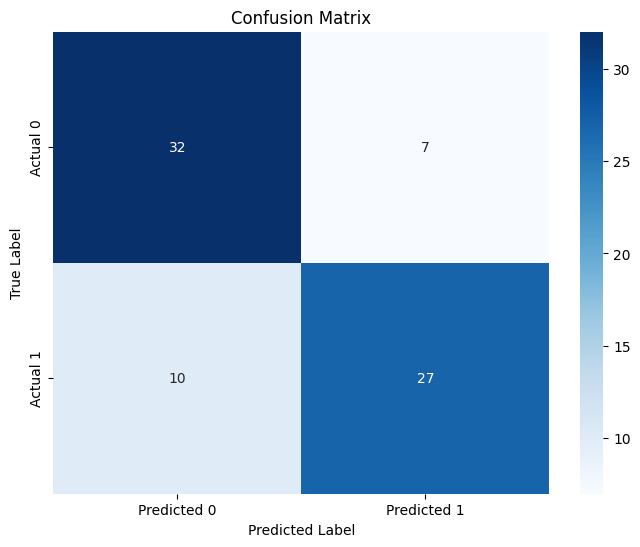

In [194]:
cm = confusion_matrix(y_test, y_pred_dt_2)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

## Random Forest

In [196]:
from sklearn.ensemble import RandomForestClassifier

# Pick 5% of the training set
train_size = int(0.05 * len(X_train_scaled_pca))
X_train_small = X_train_scaled_pca[:train_size]
y_train_small = y_train[:train_size]

# Set regularization to zero and train Random Forest
rf = RandomForestClassifier(ccp_alpha=0, random_state=42)  # ccp_alpha=0 effectively sets regularization to zero
rf.fit(X_train_small, y_train_small)

# Make predictions
y_pred = rf.predict(X_train_small)

# Calculate Mean Squared Error
mse = mean_squared_error(y_train_small, y_pred)
print(f"Mean Squared Error on the small training set: {mse}")

Mean Squared Error on the small training set: 0.0


### RF without PCA

In [226]:
# Define the parameter grid for Random Forest
param_grid4_2 = {
    'n_estimators': [220,240,260],  # Number of trees in the forest
    # 'max_depth': [None, 10],  # Maximum depth of each tree
    # 'criterion': ['gini', 'entropy', 'log_loss'],
    'min_samples_split': [3,5,10,20],
    'min_samples_leaf': [4, 6, 8,10,12]
}

# Initialize Random Forest Classifier
rf = RandomForestClassifier(random_state=42)

# Perform GridSearchCV
grid_search4_2 = GridSearchCV(rf, param_grid4_2, cv=5, scoring='accuracy')
start = time()
grid_search4_2.fit(X_train_scaled, y_train)
end = time()
print("search time: ", end - start)
# Print the best hyperparameters and accuracy
print("Best hyperparameters:", grid_search4_2.best_params_)
print("Validation accuracy:", grid_search4_2.best_score_)

search time:  122.95883584022522
Best hyperparameters: {'min_samples_leaf': 8, 'min_samples_split': 3, 'n_estimators': 240}
Validation accuracy: 0.8369082125603866


In [229]:
# use the best hyperparameter to train on whole train set
tuned_rf_2 = RandomForestClassifier(criterion='gini', n_estimators=240, min_samples_leaf=8, min_samples_split=3, max_depth=None, random_state=42)
tuned_rf_2.fit(X_train_scaled, y_train)

y_train_pred = tuned_rf_2.predict(X_train_scaled)
y_pred_rf_2 = tuned_rf_2.predict(X_test_scaled)
print(f"Training Accuracy: {accuracy_score(y_train, y_train_pred)}")
print(f"Testing Accuracy: {accuracy_score(y_test, y_pred_rf_2)}")

Training Accuracy: 0.8678414096916299
Testing Accuracy: 0.868421052631579


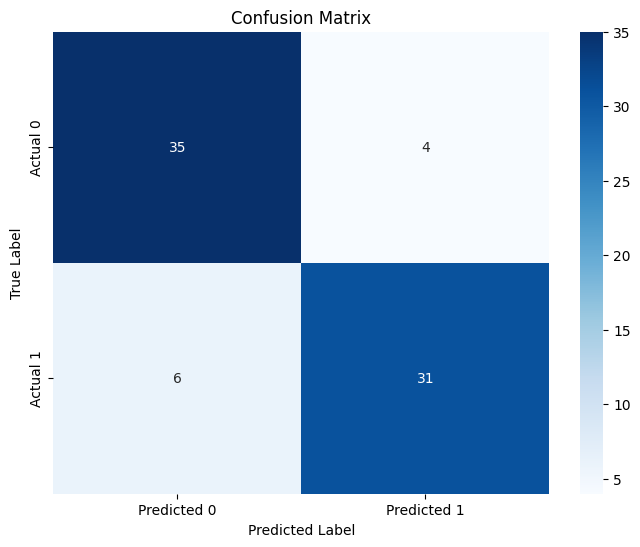

In [223]:
cm = confusion_matrix(y_test, y_pred_rf_2)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

## CatBoost

### 1. try it

In [79]:
from catboost import CatBoostClassifier, Pool, metrics, cv
from sklearn.metrics import accuracy_score

In [80]:
categorical_features_indices = np.where(Features.dtypes != float)[0]

In [87]:
model = CatBoostClassifier(
    custom_loss=[metrics.Accuracy()],
    early_stopping_rounds=50, # stop training if the validation error does not decrease for 50 iterations
    random_seed=42,
    logging_level='Silent'
)

model.fit(
    X_train, y_train,
    cat_features=categorical_features_indices,
    eval_set=(X_val, y_val),
    # eval_set=(X_validation, y_validation),
    # logging_level='Verbose',  # you can uncomment this for text output
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [88]:
# training accuracy
y_train_pred = model.predict(X_train)
print(f"Training Accuracy: {accuracy_score(y_train, y_train_pred)}")

Training Accuracy: 0.9289099526066351


In [89]:
y_pred_cat = model.predict(X_test)
print(f"Testing Accuracy: {accuracy_score(y_test, y_pred_cat)}")


Testing Accuracy: 0.9130434782608695


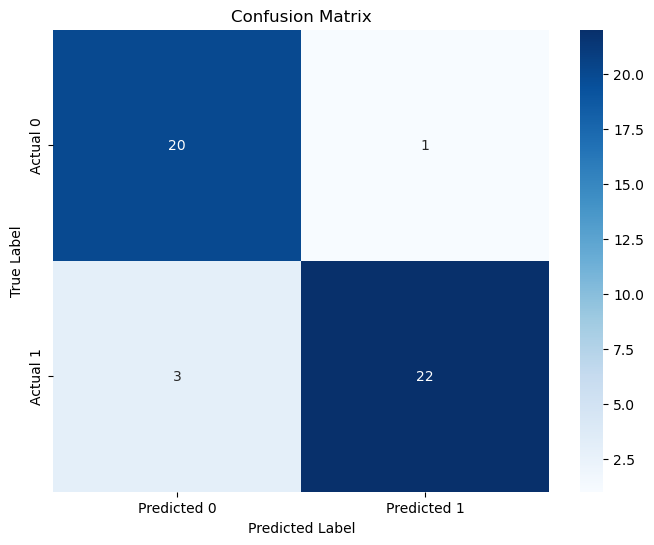

In [86]:
cm = confusion_matrix(y_test, y_pred_cat)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

In [91]:
model.save_model('/Users/yujieming/Desktop/catboost_heart.cbm')

### 2. hyperparameter tuning

good old grid search

In [57]:
# Define the parameter grid for Random Forest
param_grid_cat = {
    'learning_rate': [0.01, 0.03, 0.05],       # defautl 0.03
    'depth':[4, 5, 6, 7, 8],                   # default 6       
    'l2_leaf_reg': [1, 2, 3, 4, 5],            # default 3
    # 'boosting_type': ['Ordered', 'Plain']
}

# Initialize Random Forest Classifier
cat = CatBoostClassifier(random_state=42)

# Perform GridSearchCV
grid_search_cat = GridSearchCV(cat, param_grid_cat, cv=5, scoring='accuracy')
start = time()
grid_search_cat.fit(X_train, y_train)
end = time()
print("search time: ", end - start)
# Print the best hyperparameters and accuracy
print("Best hyperparameters:", grid_search_cat.best_params_)
print("Validation accuracy:", grid_search_cat.best_score_)

0:	learn: 0.6886121	total: 391us	remaining: 391ms
1:	learn: 0.6835017	total: 786us	remaining: 393ms
2:	learn: 0.6792466	total: 1.07ms	remaining: 356ms
3:	learn: 0.6725756	total: 1.3ms	remaining: 324ms
4:	learn: 0.6667362	total: 1.54ms	remaining: 307ms
5:	learn: 0.6615701	total: 1.84ms	remaining: 305ms
6:	learn: 0.6554884	total: 2.58ms	remaining: 366ms
7:	learn: 0.6501308	total: 2.93ms	remaining: 364ms
8:	learn: 0.6452280	total: 3.42ms	remaining: 376ms
9:	learn: 0.6379303	total: 3.63ms	remaining: 359ms
10:	learn: 0.6344832	total: 3.91ms	remaining: 351ms
11:	learn: 0.6295947	total: 4.26ms	remaining: 350ms
12:	learn: 0.6232484	total: 4.58ms	remaining: 348ms
13:	learn: 0.6168955	total: 4.89ms	remaining: 345ms
14:	learn: 0.6116141	total: 5.18ms	remaining: 340ms
15:	learn: 0.6065013	total: 5.5ms	remaining: 338ms
16:	learn: 0.5992131	total: 5.75ms	remaining: 333ms
17:	learn: 0.5938287	total: 5.96ms	remaining: 325ms
18:	learn: 0.5894989	total: 6.16ms	remaining: 318ms
19:	learn: 0.5854687	total

In [60]:
tuned_cat = CatBoostClassifier(learning_rate=0.01, depth=5, l2_leaf_reg=2, random_state=42)
tuned_cat.fit(X_train, y_train)
y_train_pred_grid = tuned_cat.predict(X_train)
y_pred_cat_grid = tuned_cat.predict(X_test)
print(f"Training Accuracy: {accuracy_score(y_train, y_train_pred_grid)}")
print(f"Testing Accuracy: {accuracy_score(y_test, y_pred_cat_grid)}")



0:	learn: 0.6877153	total: 644us	remaining: 643ms
1:	learn: 0.6792673	total: 1.28ms	remaining: 640ms
2:	learn: 0.6703959	total: 1.8ms	remaining: 597ms
3:	learn: 0.6651000	total: 2.28ms	remaining: 567ms
4:	learn: 0.6598633	total: 2.91ms	remaining: 580ms
5:	learn: 0.6538136	total: 3.31ms	remaining: 549ms
6:	learn: 0.6481870	total: 4.37ms	remaining: 620ms
7:	learn: 0.6416732	total: 4.74ms	remaining: 588ms
8:	learn: 0.6350078	total: 5.19ms	remaining: 572ms
9:	learn: 0.6280928	total: 5.83ms	remaining: 577ms
10:	learn: 0.6206794	total: 6.29ms	remaining: 566ms
11:	learn: 0.6125976	total: 6.85ms	remaining: 564ms
12:	learn: 0.6064532	total: 7.26ms	remaining: 551ms
13:	learn: 0.5995917	total: 7.63ms	remaining: 537ms
14:	learn: 0.5943003	total: 7.99ms	remaining: 524ms
15:	learn: 0.5879274	total: 8.33ms	remaining: 512ms
16:	learn: 0.5818929	total: 8.69ms	remaining: 502ms
17:	learn: 0.5755317	total: 9.1ms	remaining: 496ms
18:	learn: 0.5696845	total: 9.47ms	remaining: 489ms
19:	learn: 0.5655318	tota

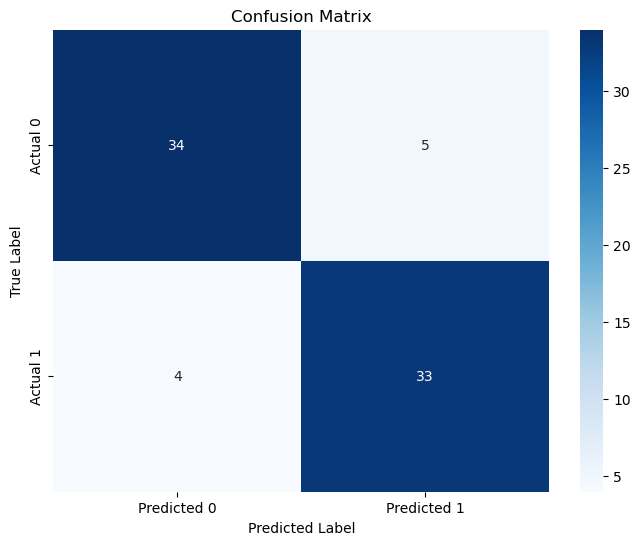

In [61]:
cm = confusion_matrix(y_test, y_pred_cat_grid)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Predicted 0', 'Predicted 1'],
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()